In [ ]:
import torch
from torch import nn, optim
from torchvision import transforms, datasets
import matplotlib.pyplot as plt

In [ ]:
# Set random seed for reproducibility
torch.manual_seed(42)

# Hyperparameters
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
batch_size = 100
learning_rate = 0.0002
num_epochs = 81
num_test_samples = 32

In [ ]:
# Data loading and preprocessing
transform = transforms.Compose([
    transforms.Resize(64),
    transforms.ToTensor(),
    transforms.Normalize((.5, .5, .5), (.5, .5, .5))
])

cifar10_dataset = datasets.CIFAR10(root='./data', train=False, transform=transform, download=True)
data_loader = torch.utils.data.DataLoader(cifar10_dataset, batch_size=batch_size, shuffle=True)

Files already downloaded and verified


In [ ]:
# Generator model
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.linear = nn.Linear(100, 1024*4*4)
        self.deconv = nn.Sequential(
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.linear(x)
        x = x.view(x.size(0), 1024, 4, 4)
        x = self.deconv(x)
        return x

In [ ]:
# Discriminator model
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(3, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.output = nn.Sequential(
            nn.Linear(1024*4*4, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.conv(x)
        x = x.view(x.size(0), 1024*4*4)
        x = self.output(x)
        return x


In [ ]:
# Initialize generator and discriminator
generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Weight initialization
def weights_init(module):
    if isinstance(module, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(module.weight.data, 0.0, 0.02)
    elif isinstance(module, nn.BatchNorm2d):
        nn.init.normal_(module.weight.data, 1.0, 0.02)
        nn.init.constant_(module.bias.data, 0)

In [ ]:
from torchvision.utils import make_grid

Epoch [1/81], Discriminator Loss: 0.8361, Generator Loss: 6.9530


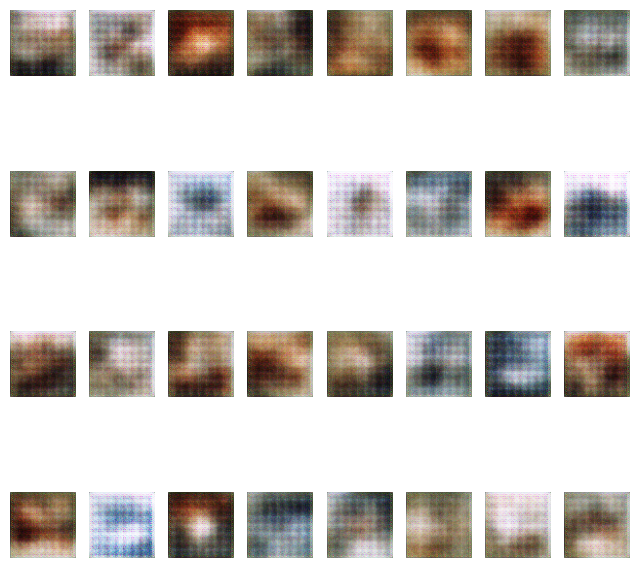

Epoch [2/81], Discriminator Loss: 0.9073, Generator Loss: 3.5330


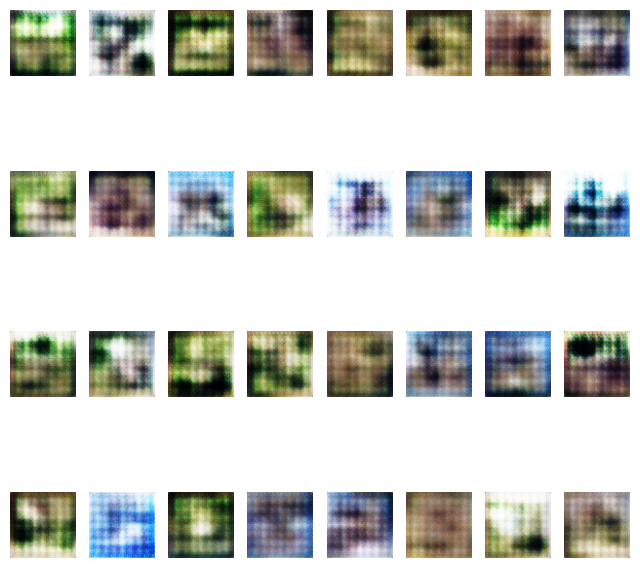

Epoch [3/81], Discriminator Loss: 0.9011, Generator Loss: 3.0658
Epoch [4/81], Discriminator Loss: 0.9325, Generator Loss: 2.8463


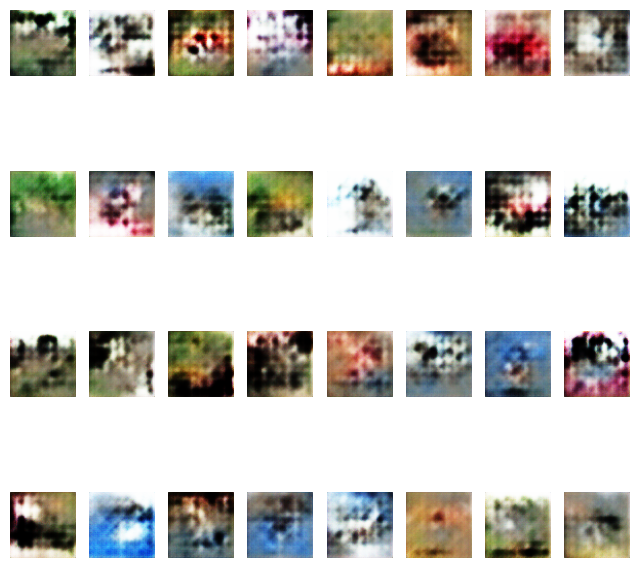

Epoch [5/81], Discriminator Loss: 0.9748, Generator Loss: 2.4908
Epoch [6/81], Discriminator Loss: 0.9213, Generator Loss: 2.6428


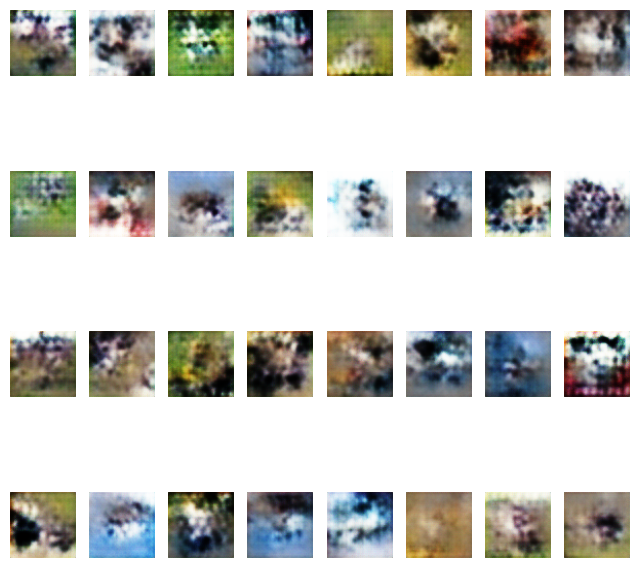

Epoch [7/81], Discriminator Loss: 0.9501, Generator Loss: 2.6461
Epoch [8/81], Discriminator Loss: 0.9195, Generator Loss: 2.6219


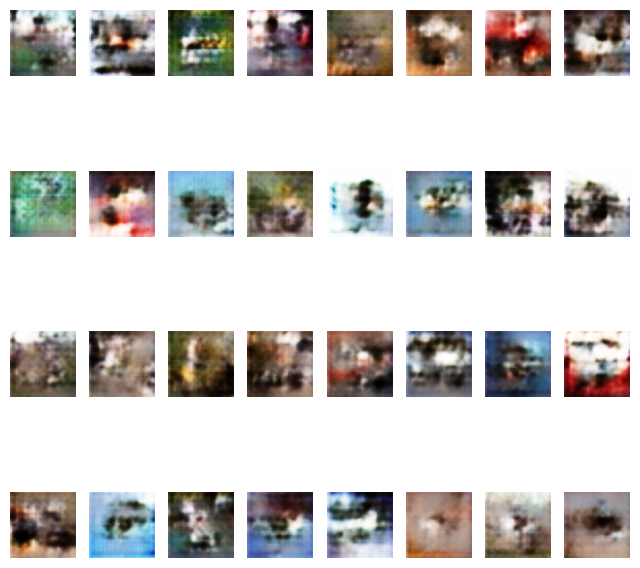

Epoch [9/81], Discriminator Loss: 0.8307, Generator Loss: 2.7590
Epoch [10/81], Discriminator Loss: 0.8062, Generator Loss: 2.9154


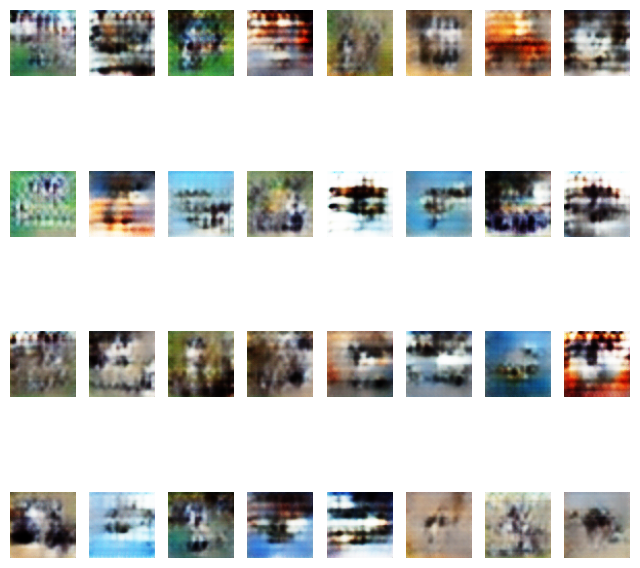

Epoch [11/81], Discriminator Loss: 0.8763, Generator Loss: 2.9829
Epoch [12/81], Discriminator Loss: 0.8389, Generator Loss: 2.8717


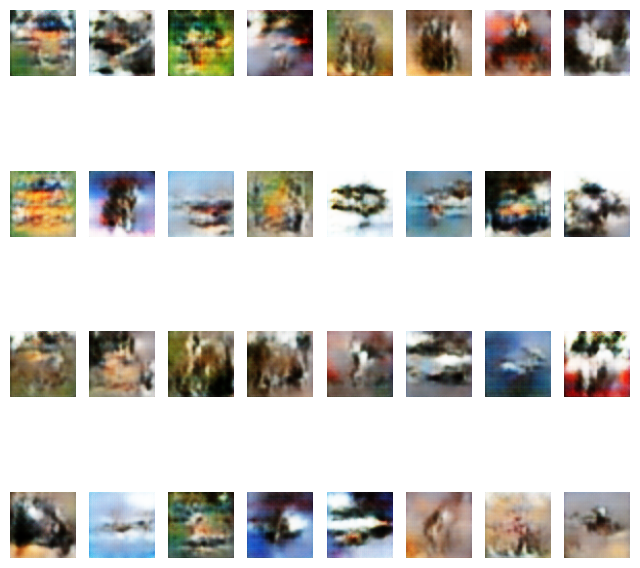

Epoch [13/81], Discriminator Loss: 0.9393, Generator Loss: 2.5116
Epoch [14/81], Discriminator Loss: 0.8758, Generator Loss: 2.6022


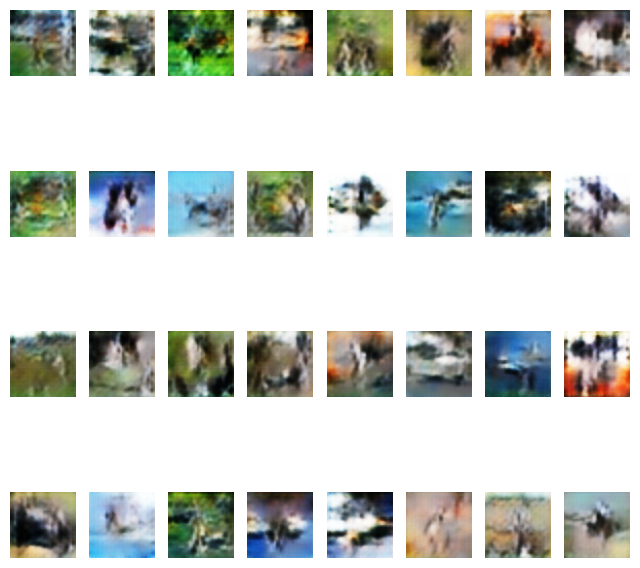

Epoch [15/81], Discriminator Loss: 0.8946, Generator Loss: 2.5726
Epoch [16/81], Discriminator Loss: 0.9032, Generator Loss: 2.5400


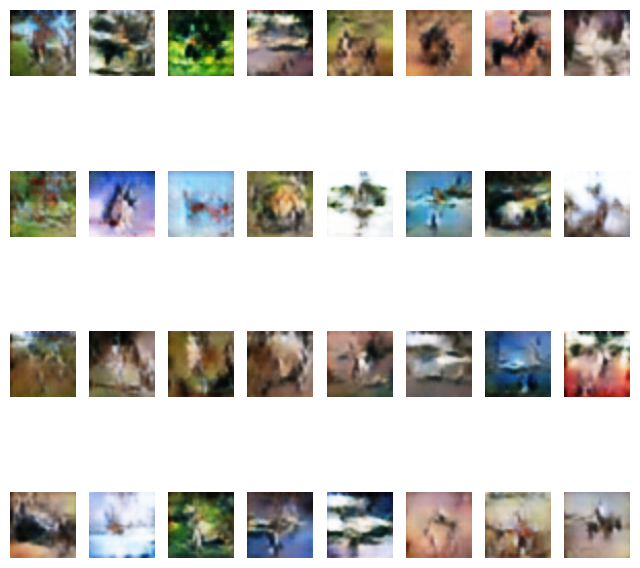

Epoch [17/81], Discriminator Loss: 0.9158, Generator Loss: 2.6007
Epoch [18/81], Discriminator Loss: 0.6648, Generator Loss: 2.8624


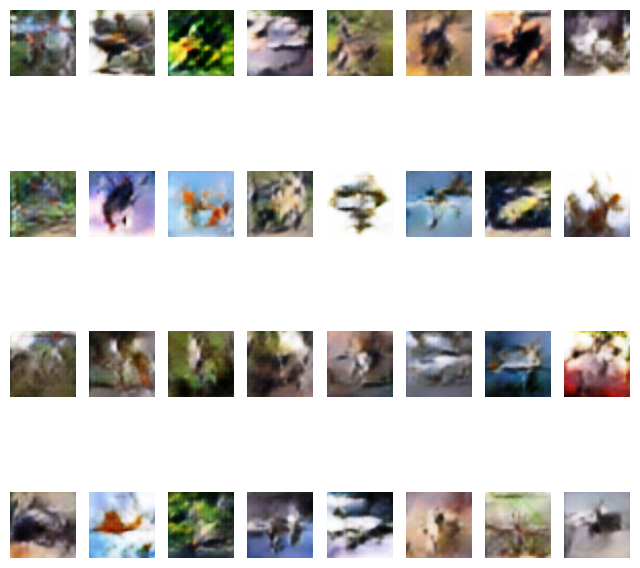

Epoch [19/81], Discriminator Loss: 0.8644, Generator Loss: 2.7289
Epoch [20/81], Discriminator Loss: 0.7083, Generator Loss: 2.9247


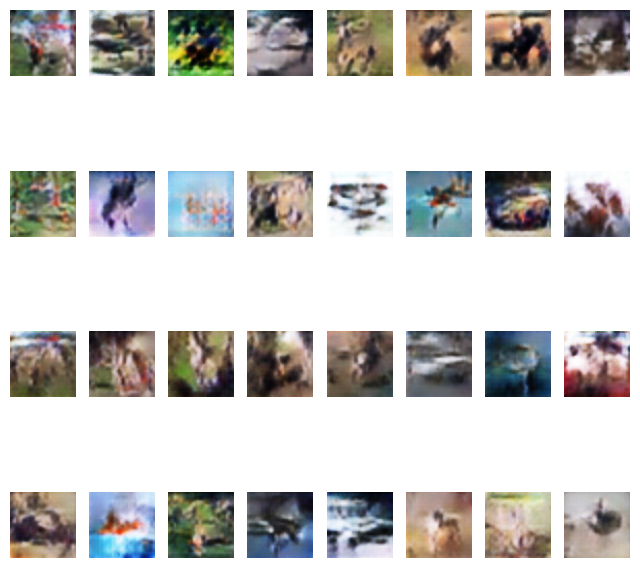

Epoch [21/81], Discriminator Loss: 0.6257, Generator Loss: 3.6022
Epoch [22/81], Discriminator Loss: 1.0563, Generator Loss: 2.2873


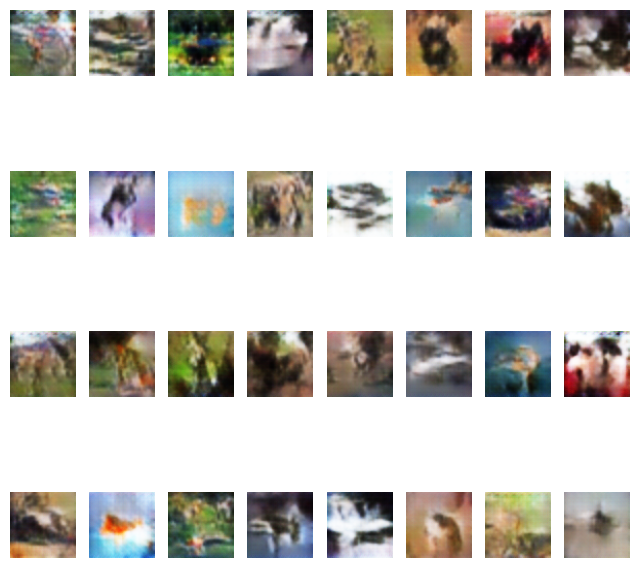

Epoch [23/81], Discriminator Loss: 0.7181, Generator Loss: 2.8724
Epoch [24/81], Discriminator Loss: 0.8225, Generator Loss: 2.7764


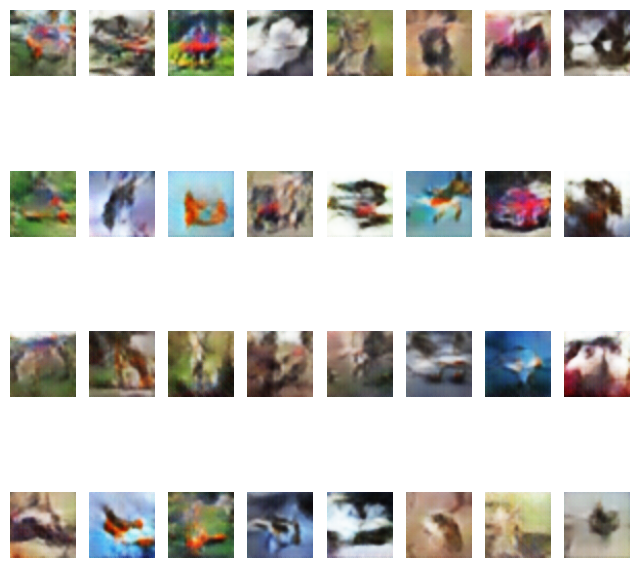

Epoch [25/81], Discriminator Loss: 0.7914, Generator Loss: 2.9752
Epoch [26/81], Discriminator Loss: 0.5689, Generator Loss: 3.7693


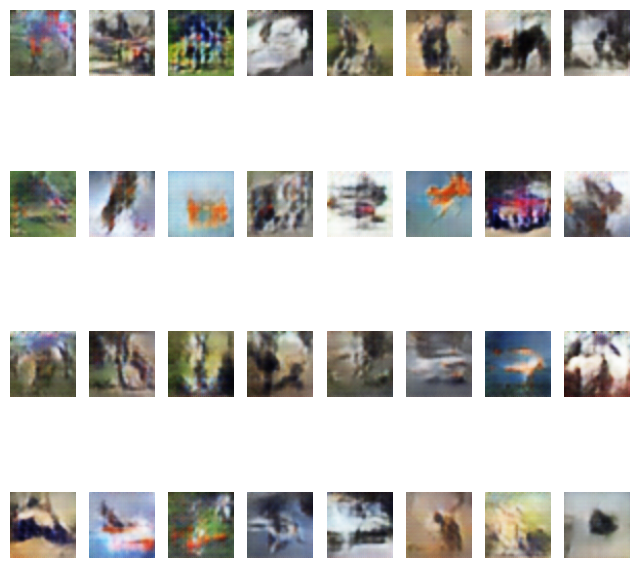

Epoch [27/81], Discriminator Loss: 0.7438, Generator Loss: 3.3696
Epoch [28/81], Discriminator Loss: 0.5207, Generator Loss: 4.0499


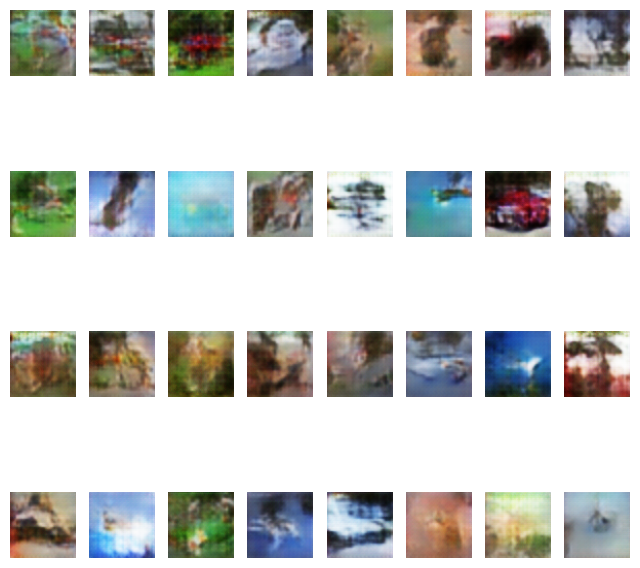

Epoch [29/81], Discriminator Loss: 0.3643, Generator Loss: 4.3850
Epoch [30/81], Discriminator Loss: 1.1400, Generator Loss: 2.3692


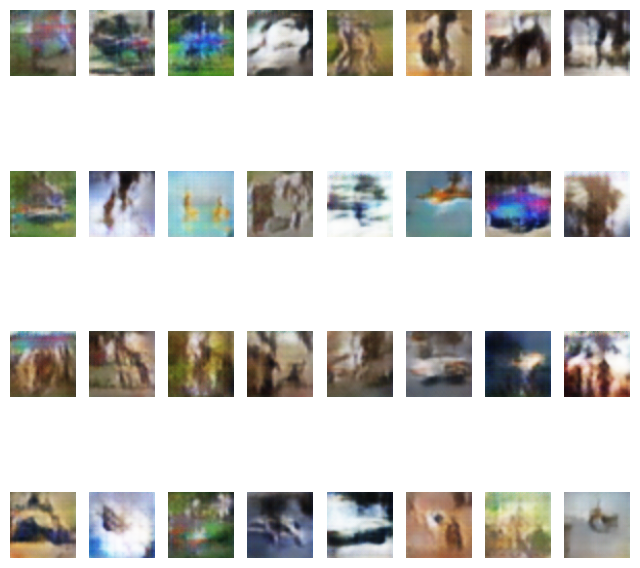

Epoch [31/81], Discriminator Loss: 0.8099, Generator Loss: 2.6034
Epoch [32/81], Discriminator Loss: 0.9084, Generator Loss: 2.7572


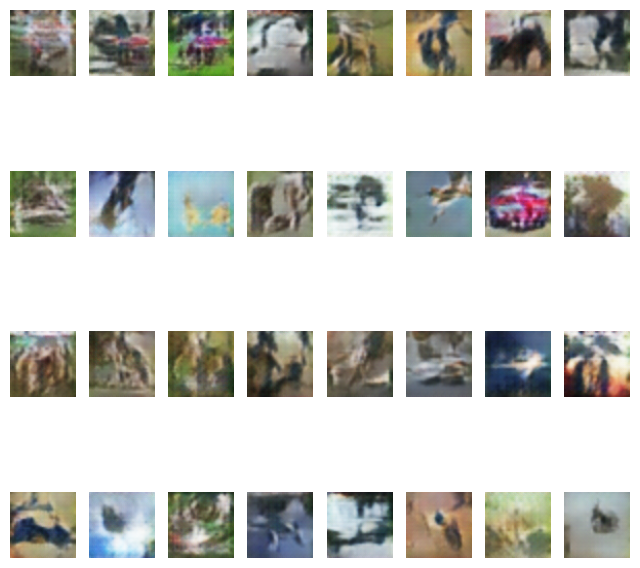

Epoch [33/81], Discriminator Loss: 0.8398, Generator Loss: 2.7424
Epoch [34/81], Discriminator Loss: 0.5412, Generator Loss: 3.6633


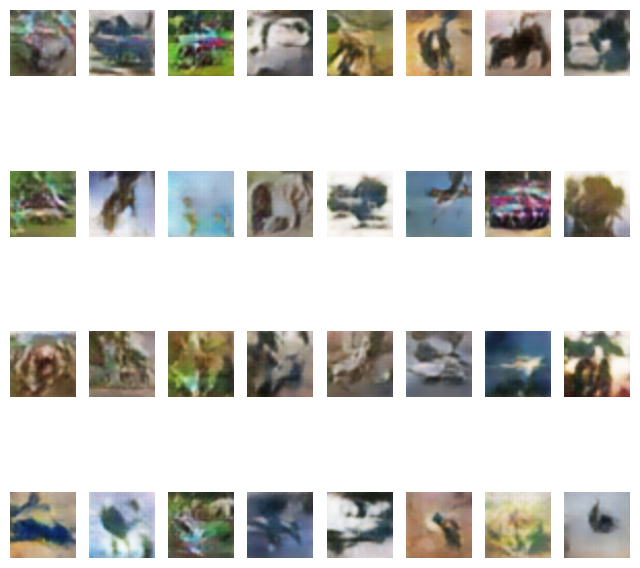

Epoch [35/81], Discriminator Loss: 0.8238, Generator Loss: 2.7194
Epoch [36/81], Discriminator Loss: 0.5027, Generator Loss: 3.7392


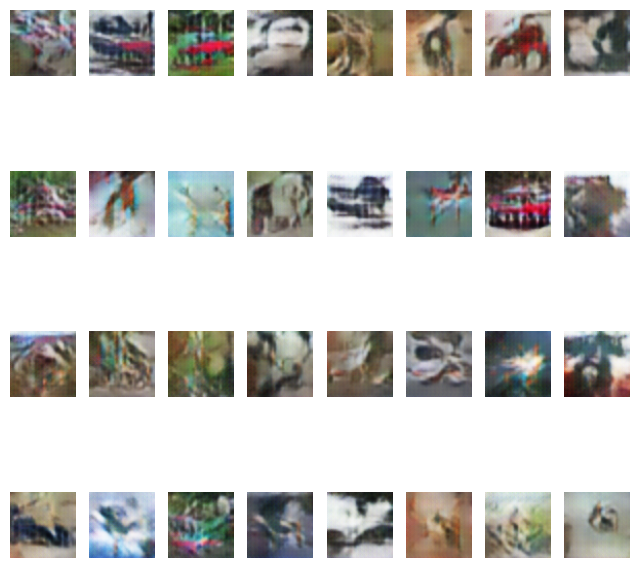

Epoch [37/81], Discriminator Loss: 0.0296, Generator Loss: 6.0641
Epoch [38/81], Discriminator Loss: 0.2486, Generator Loss: 7.3519


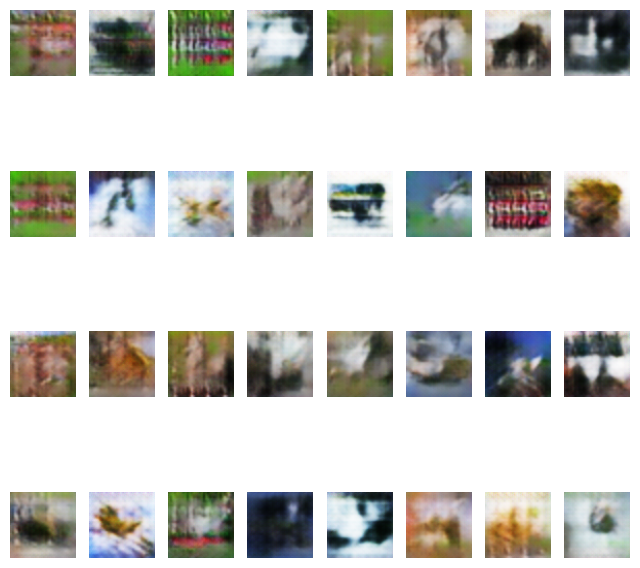

Epoch [39/81], Discriminator Loss: 0.3952, Generator Loss: 4.1126
Epoch [40/81], Discriminator Loss: 0.6291, Generator Loss: 3.5616


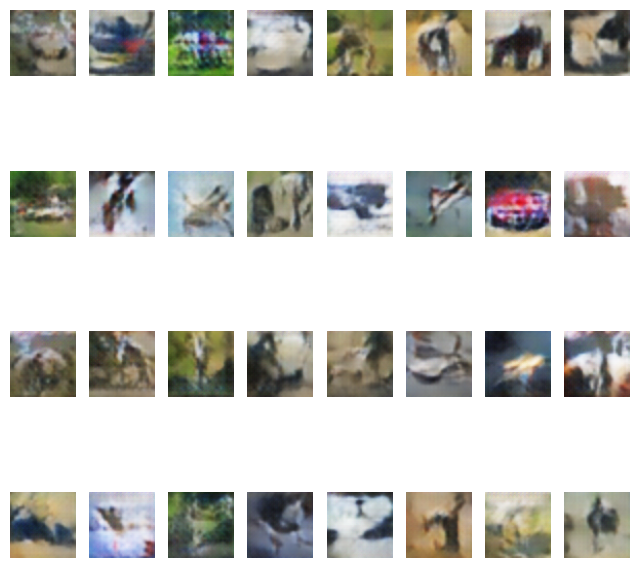

Epoch [41/81], Discriminator Loss: 0.7911, Generator Loss: 3.0859
Epoch [42/81], Discriminator Loss: 0.8508, Generator Loss: 2.6419


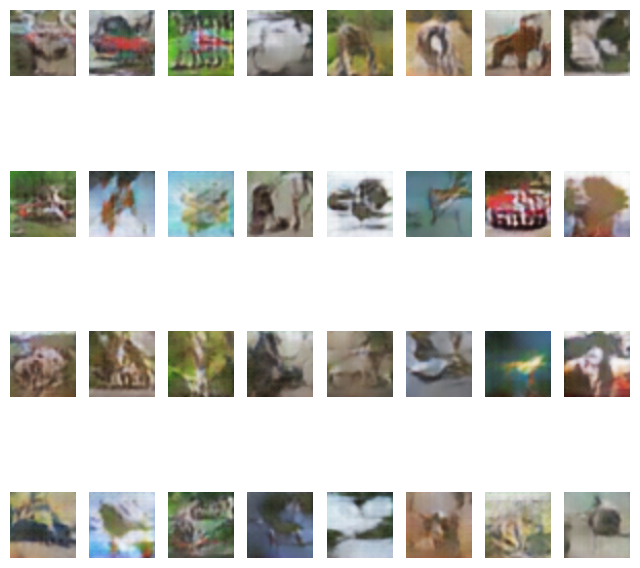

Epoch [43/81], Discriminator Loss: 0.7752, Generator Loss: 2.8604
Epoch [44/81], Discriminator Loss: 0.9651, Generator Loss: 2.5754


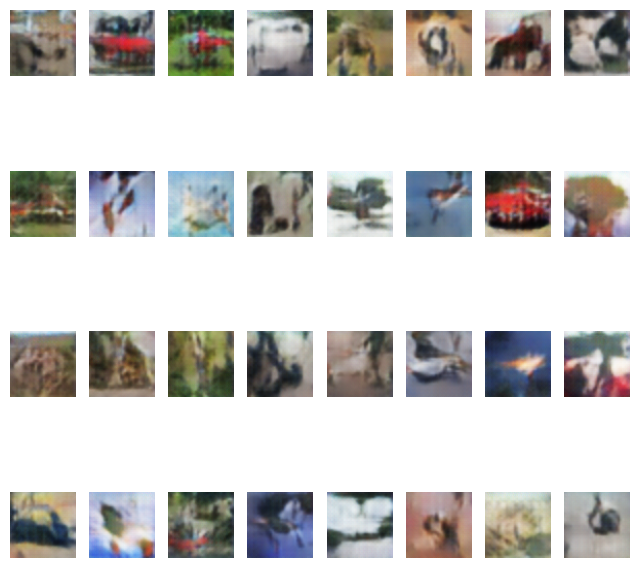

Epoch [45/81], Discriminator Loss: 0.7450, Generator Loss: 2.8094
Epoch [46/81], Discriminator Loss: 0.9269, Generator Loss: 2.2646


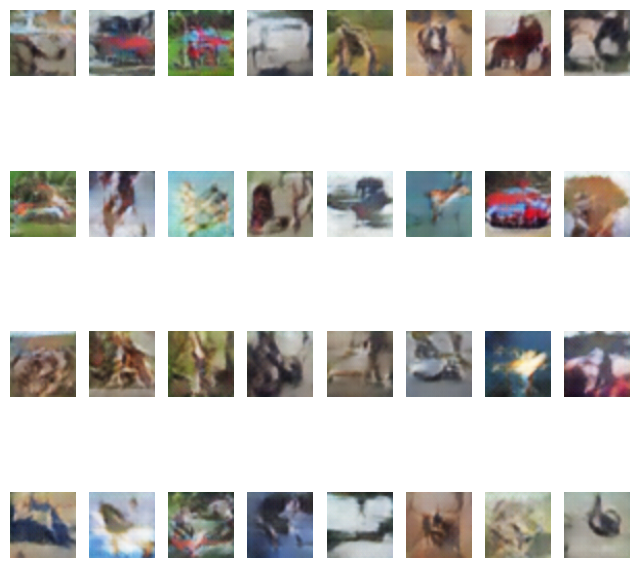

Epoch [47/81], Discriminator Loss: 0.4671, Generator Loss: 3.6582
Epoch [48/81], Discriminator Loss: 0.6142, Generator Loss: 3.8398


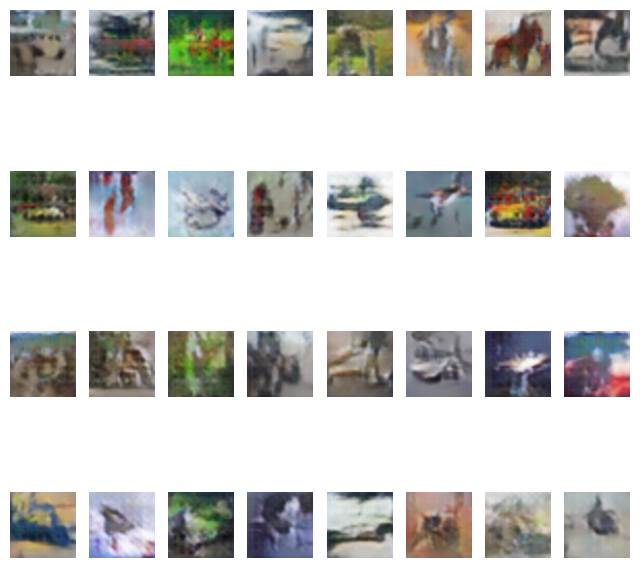

Epoch [49/81], Discriminator Loss: 0.9145, Generator Loss: 2.4481
Epoch [50/81], Discriminator Loss: 0.8847, Generator Loss: 2.5421


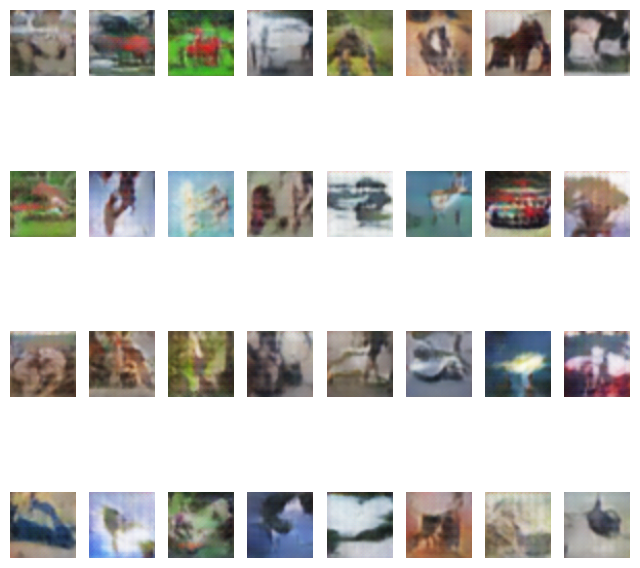

Epoch [51/81], Discriminator Loss: 0.3046, Generator Loss: 4.1845
Epoch [52/81], Discriminator Loss: 0.8440, Generator Loss: 2.6595


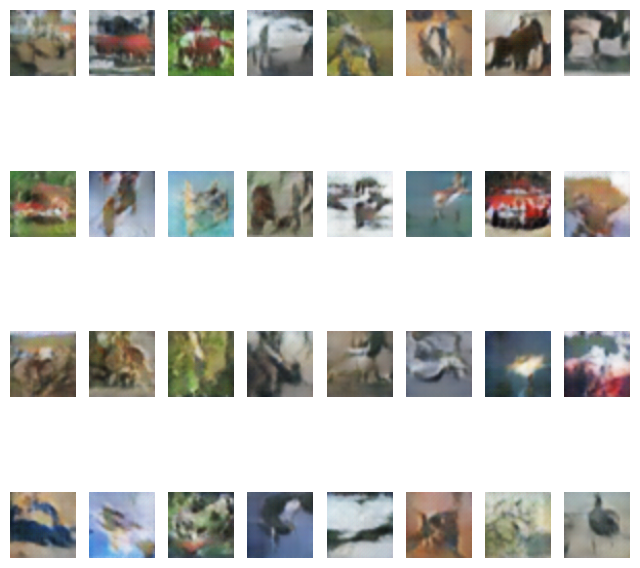

Epoch [53/81], Discriminator Loss: 0.8539, Generator Loss: 2.6530
Epoch [54/81], Discriminator Loss: 0.4896, Generator Loss: 3.4807


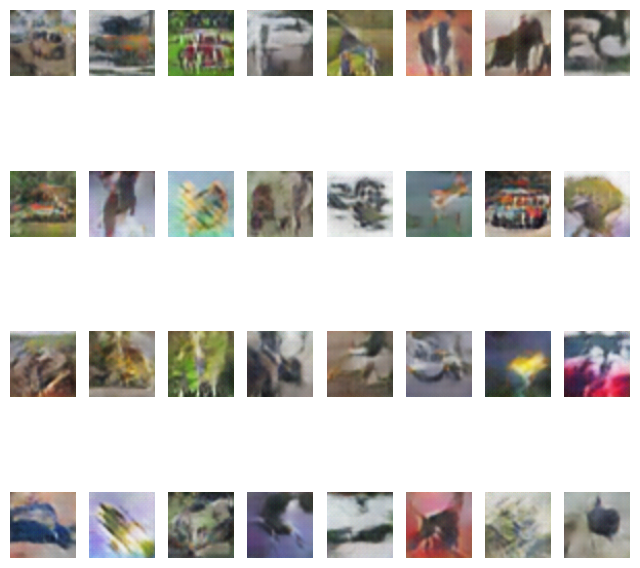

Epoch [55/81], Discriminator Loss: 0.4504, Generator Loss: 4.1253
Epoch [56/81], Discriminator Loss: 0.5065, Generator Loss: 4.1071


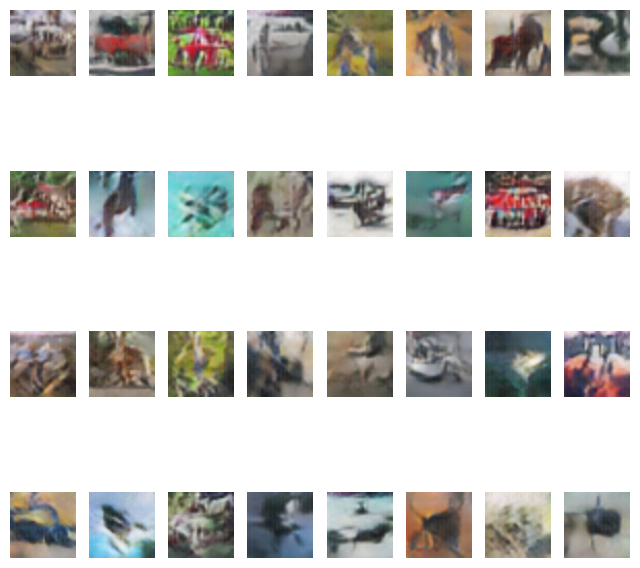

Epoch [57/81], Discriminator Loss: 0.6605, Generator Loss: 3.8299
Epoch [58/81], Discriminator Loss: 0.8198, Generator Loss: 3.0565


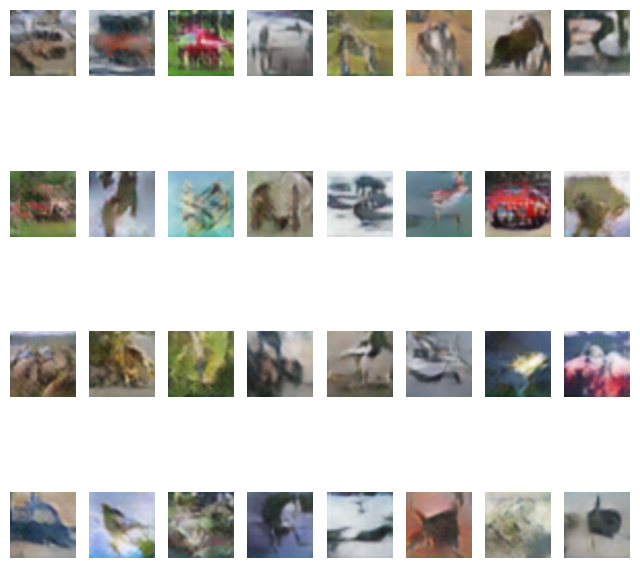

Epoch [59/81], Discriminator Loss: 0.8510, Generator Loss: 2.7235
Epoch [60/81], Discriminator Loss: 0.9287, Generator Loss: 1.8169


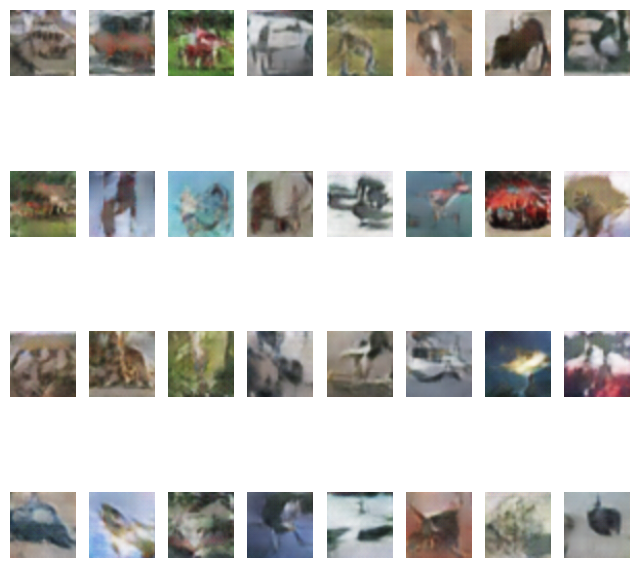

Epoch [61/81], Discriminator Loss: 0.7213, Generator Loss: 2.4041
Epoch [62/81], Discriminator Loss: 0.4044, Generator Loss: 4.2478


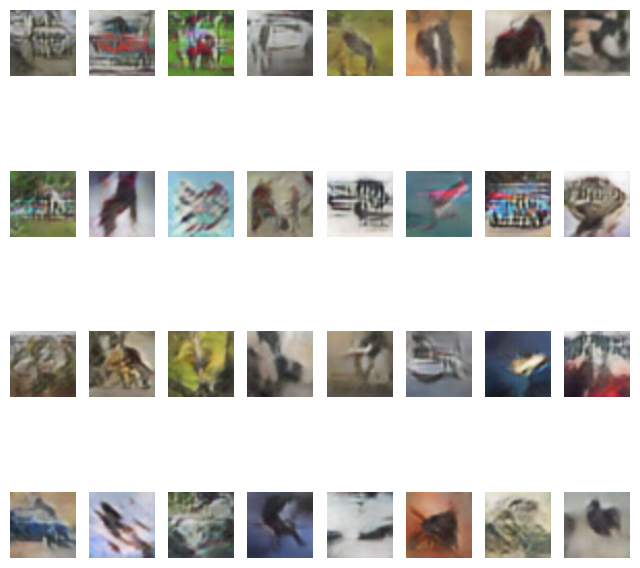

Epoch [63/81], Discriminator Loss: 0.3199, Generator Loss: 5.3767
Epoch [64/81], Discriminator Loss: 0.6881, Generator Loss: 2.9615


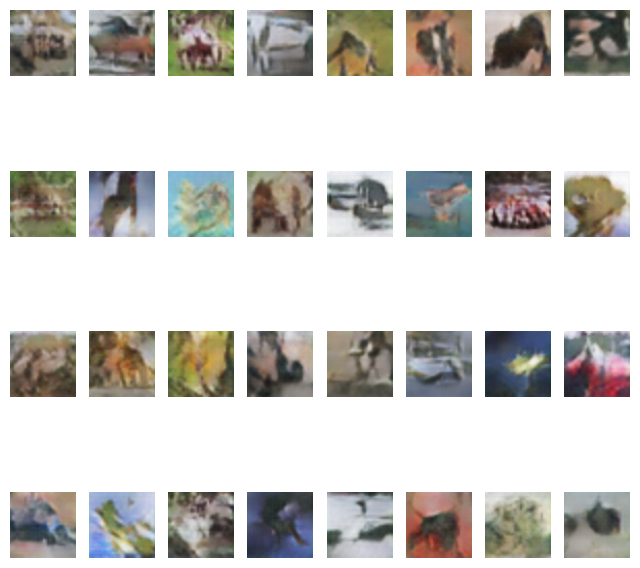

Epoch [65/81], Discriminator Loss: 0.7577, Generator Loss: 3.0117
Epoch [66/81], Discriminator Loss: 0.0555, Generator Loss: 5.7716


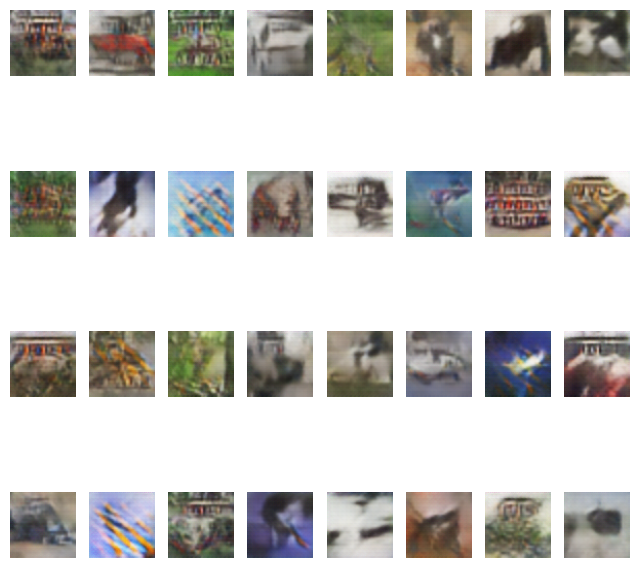

Epoch [67/81], Discriminator Loss: 0.6984, Generator Loss: 3.6789
Epoch [68/81], Discriminator Loss: 0.8108, Generator Loss: 2.6586


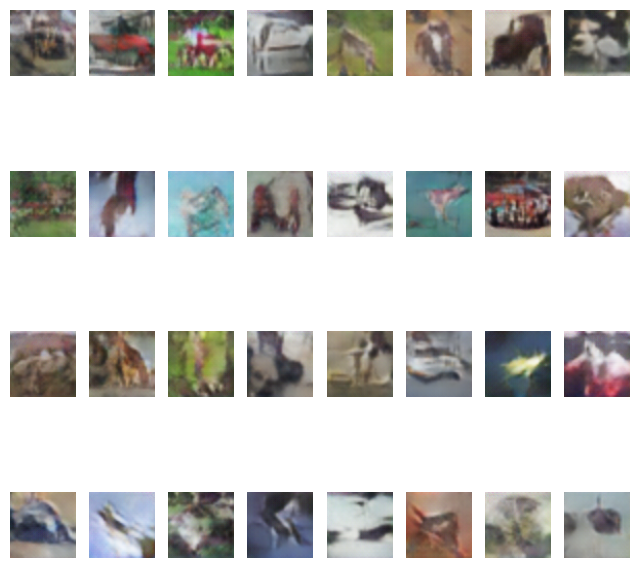

Epoch [69/81], Discriminator Loss: 0.6963, Generator Loss: 2.7354
Epoch [70/81], Discriminator Loss: 0.6562, Generator Loss: 2.8275


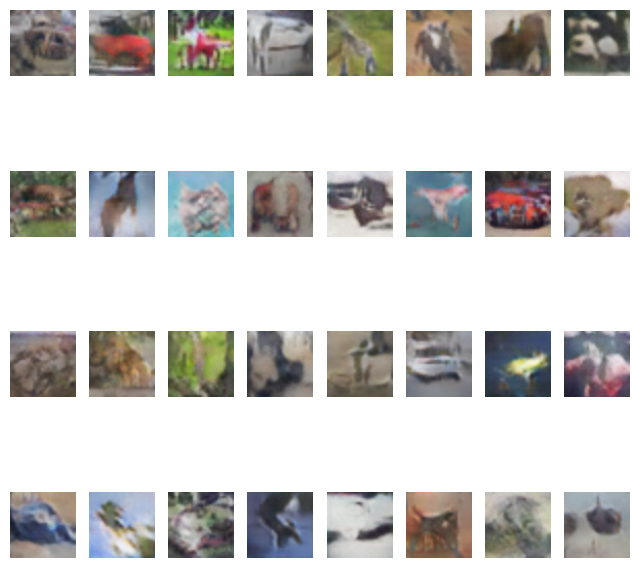

Epoch [71/81], Discriminator Loss: 0.5498, Generator Loss: 3.4789
Epoch [72/81], Discriminator Loss: 0.0290, Generator Loss: 6.0300


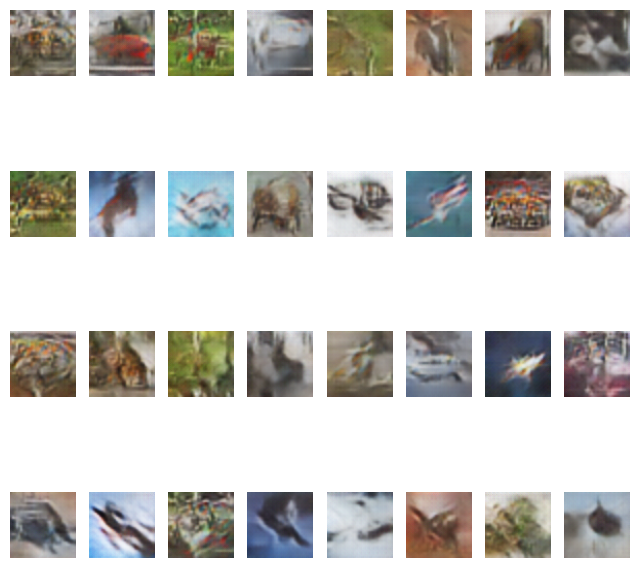

Epoch [73/81], Discriminator Loss: 0.0163, Generator Loss: 7.3628
Epoch [74/81], Discriminator Loss: 0.5220, Generator Loss: 3.6431


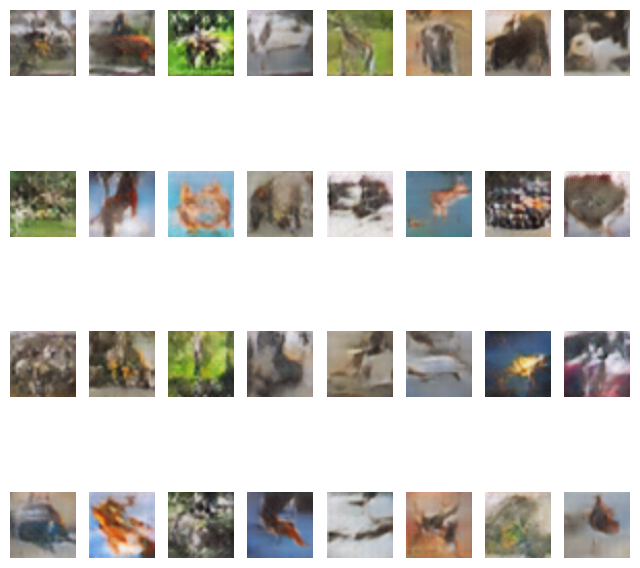

Epoch [75/81], Discriminator Loss: 0.5572, Generator Loss: 3.5871
Epoch [76/81], Discriminator Loss: 0.6596, Generator Loss: 2.8669


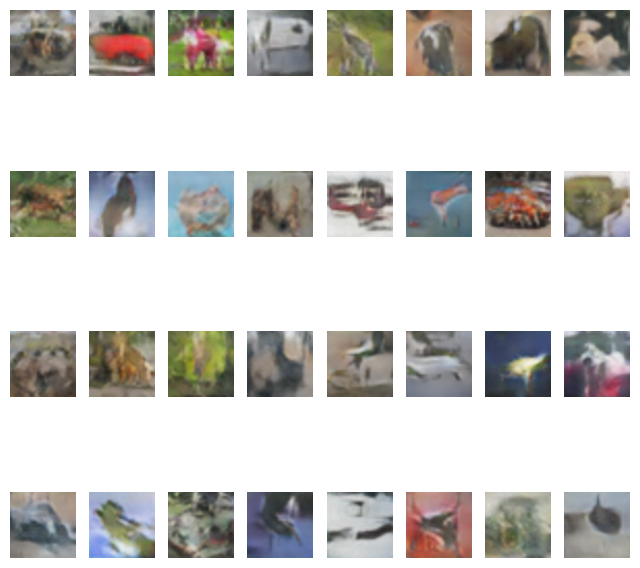

Epoch [77/81], Discriminator Loss: 0.7506, Generator Loss: 3.0051
Epoch [78/81], Discriminator Loss: 0.5172, Generator Loss: 3.6536


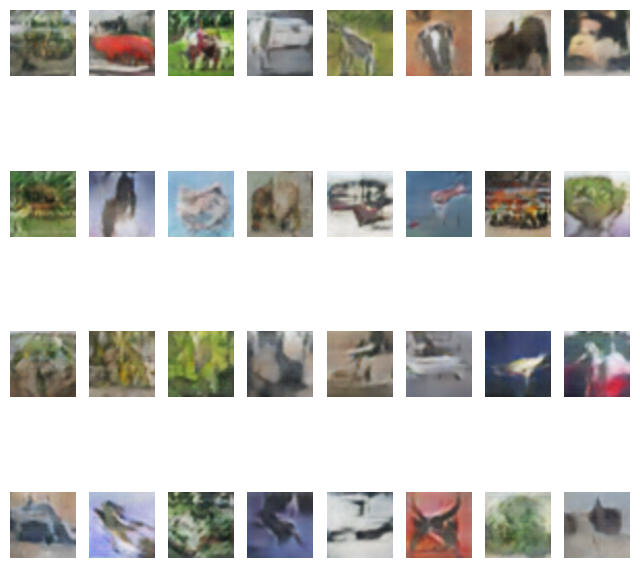

Epoch [79/81], Discriminator Loss: 0.2035, Generator Loss: 5.1494
Epoch [80/81], Discriminator Loss: 0.3851, Generator Loss: 5.2792


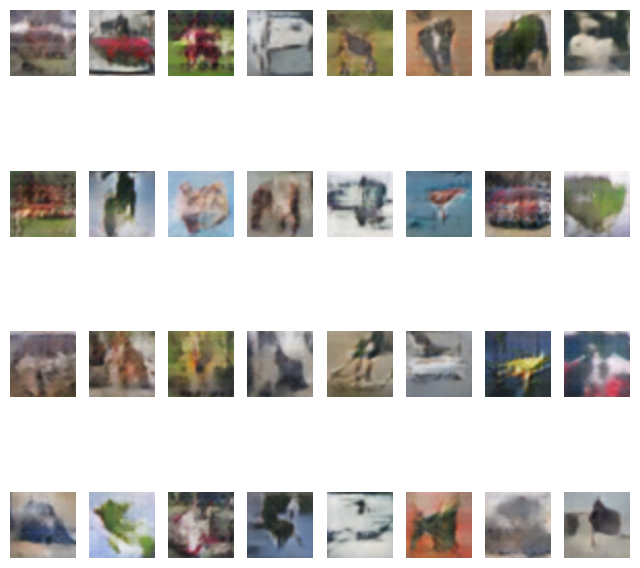

Epoch [81/81], Discriminator Loss: 0.6023, Generator Loss: 3.0100


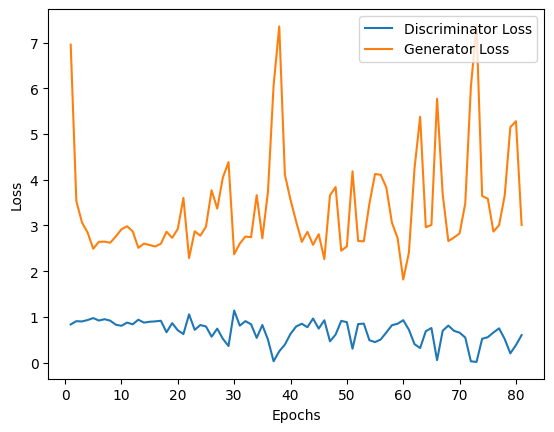

In [ ]:
generator.apply(weights_init)
discriminator.apply(weights_init)

# Loss function
criterion = nn.BCELoss()

# Optimizers
g_optimizer = optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.999))

# Fixed noise for visualization
fixed_noise = torch.randn(num_test_samples, 100, device=device)

# Training loop
discriminator_losses = []
generator_losses = []

for epoch in range(num_epochs):
    # Initialize loss variables for this epoch
    epoch_discriminator_loss = 0
    epoch_generator_loss = 0

    for i, (real_images, _) in enumerate(data_loader):
        real_images = real_images.to(device)

        # Discriminator forward pass with real images
        real_labels = torch.ones(batch_size, 1, device=device)
        real_outputs = discriminator(real_images)
        d_loss_real = criterion(real_outputs, real_labels)

        # Generator forward pass and discriminator backward pass with fake images
        noise = torch.randn(batch_size, 100, device=device)
        fake_images = generator(noise)
        fake_labels = torch.zeros(batch_size, 1, device=device)
        fake_outputs = discriminator(fake_images.detach())
        d_loss_fake = criterion(fake_outputs, fake_labels)

        d_loss = d_loss_real + d_loss_fake

        discriminator.zero_grad()
        d_loss.backward()
        d_optimizer.step()

        # Generator forward pass and discriminator backward pass with fake images
        fake_outputs = discriminator(fake_images)
        g_loss = criterion(fake_outputs, real_labels)

        generator.zero_grad()
        g_loss.backward()
        g_optimizer.step()

        # Accumulate losses for this epoch
        epoch_discriminator_loss += d_loss.item()
        epoch_generator_loss += g_loss.item()

    # Average losses for this epoch
    epoch_discriminator_loss /= len(data_loader)
    epoch_generator_loss /= len(data_loader)

    discriminator_losses.append(epoch_discriminator_loss)
    generator_losses.append(epoch_generator_loss)

    # Print progress
    print(f"Epoch [{epoch+1}/{num_epochs}], Discriminator Loss: {epoch_discriminator_loss:.4f}, Generator Loss: {epoch_generator_loss:.4f}")

    # Generate images
    with torch.no_grad():
        generated_images = generator(fixed_noise).detach().cpu()

    # Display generated images
    if (epoch+1) % 2 == 0 or epoch == 0:
        plt.figure(figsize=(8, 8))
        for j in range(num_test_samples):
            # Denormalize the image
            image = generated_images[j].permute(1, 2, 0)
            image = (image + 1) / 2  # Undo normalization

            plt.subplot(4, 8, j+1)
            plt.imshow(image)
            plt.axis('off')
        plt.show()

# Plotting the loss curve
plt.figure()
plt.plot(range(1, num_epochs+1), discriminator_losses, label="Discriminator Loss")
plt.plot(range(1, num_epochs+1), generator_losses, label="Generator Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.savefig("loss_curve.png")
plt.show()

In [ ]:
# Set random seed for reproducibility
torch.manual_seed(42)

# Hyperparameters
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
batch_size = 100
learning_rate = 0.00002
num_epochs = 91
num_test_samples = 16

Epoch [1/91], Discriminator Loss: 0.3863, Generator Loss: 3.0270


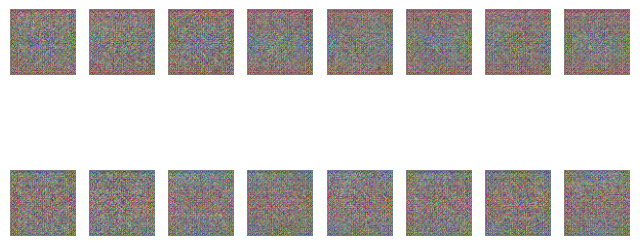

Epoch [2/91], Discriminator Loss: 0.0662, Generator Loss: 4.5142


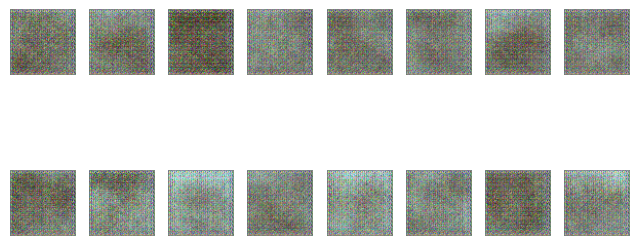

Epoch [3/91], Discriminator Loss: 0.1266, Generator Loss: 4.4966
Epoch [4/91], Discriminator Loss: 0.0732, Generator Loss: 4.6085


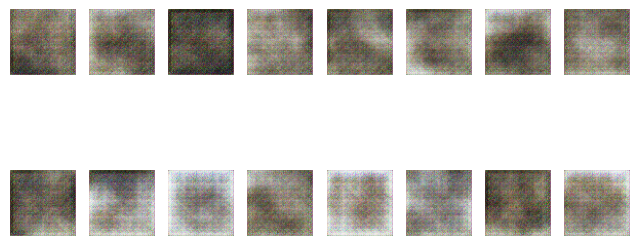

Epoch [5/91], Discriminator Loss: 0.2001, Generator Loss: 4.5438
Epoch [6/91], Discriminator Loss: 0.2465, Generator Loss: 3.7047


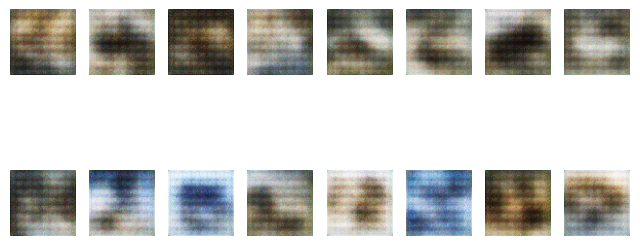

Epoch [7/91], Discriminator Loss: 0.1477, Generator Loss: 3.8268
Epoch [8/91], Discriminator Loss: 0.1091, Generator Loss: 3.9549


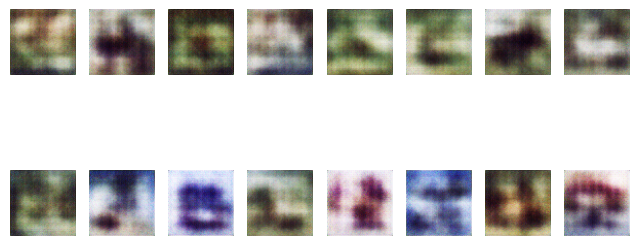

Epoch [9/91], Discriminator Loss: 0.2359, Generator Loss: 4.0478
Epoch [10/91], Discriminator Loss: 0.1351, Generator Loss: 4.0323


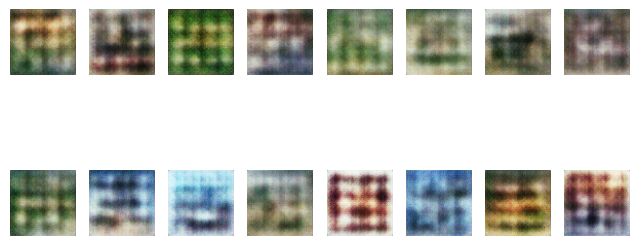

Epoch [11/91], Discriminator Loss: 0.1807, Generator Loss: 4.1229
Epoch [12/91], Discriminator Loss: 0.1789, Generator Loss: 3.9103


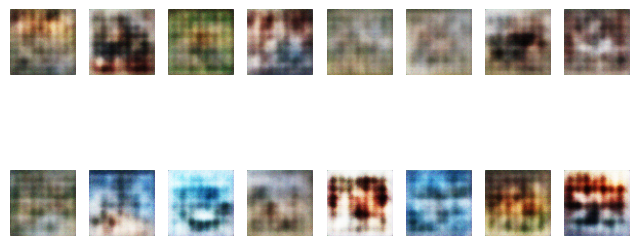

Epoch [13/91], Discriminator Loss: 0.3130, Generator Loss: 3.8906
Epoch [14/91], Discriminator Loss: 0.2583, Generator Loss: 3.7179


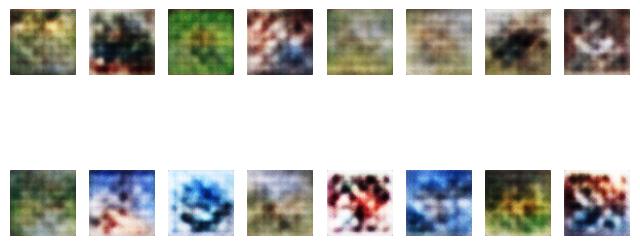

Epoch [15/91], Discriminator Loss: 0.2433, Generator Loss: 3.4935
Epoch [16/91], Discriminator Loss: 0.2935, Generator Loss: 3.3120


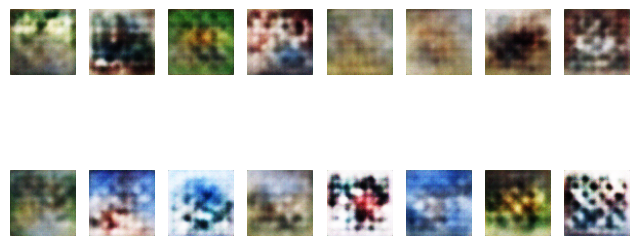

Epoch [17/91], Discriminator Loss: 0.3119, Generator Loss: 3.2223
Epoch [18/91], Discriminator Loss: 0.3417, Generator Loss: 3.1984


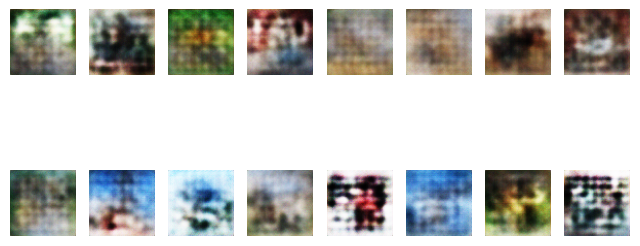

Epoch [19/91], Discriminator Loss: 0.2918, Generator Loss: 3.1311
Epoch [20/91], Discriminator Loss: 0.2660, Generator Loss: 3.0933


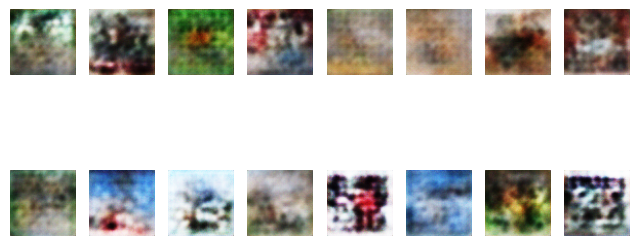

Epoch [21/91], Discriminator Loss: 0.5774, Generator Loss: 3.0747
Epoch [22/91], Discriminator Loss: 0.3246, Generator Loss: 3.0294


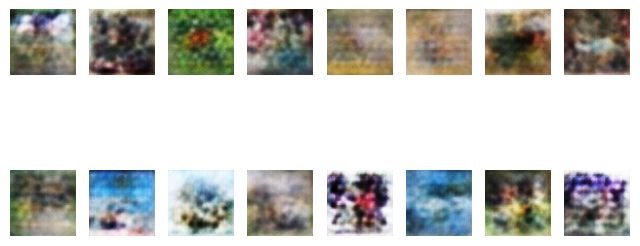

Epoch [23/91], Discriminator Loss: 0.2940, Generator Loss: 2.9722
Epoch [24/91], Discriminator Loss: 0.3060, Generator Loss: 3.0655


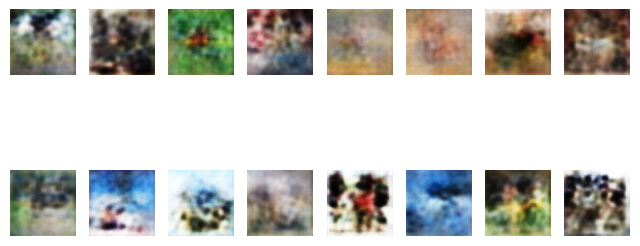

Epoch [25/91], Discriminator Loss: 0.3050, Generator Loss: 3.0542
Epoch [26/91], Discriminator Loss: 0.3064, Generator Loss: 2.9477


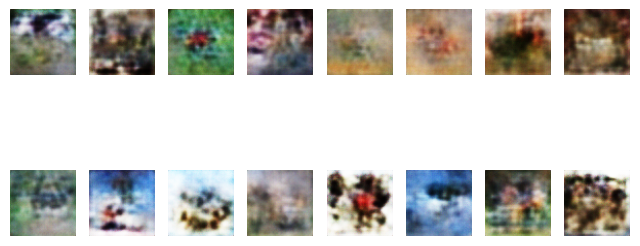

Epoch [27/91], Discriminator Loss: 0.3312, Generator Loss: 3.0056
Epoch [28/91], Discriminator Loss: 0.5552, Generator Loss: 2.9849


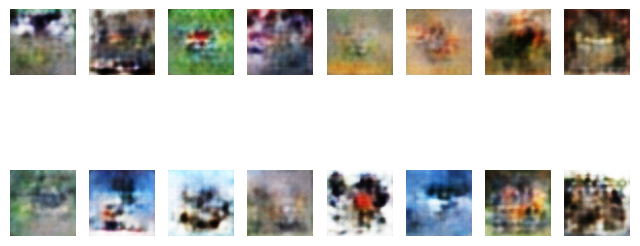

Epoch [29/91], Discriminator Loss: 0.3223, Generator Loss: 2.8826
Epoch [30/91], Discriminator Loss: 0.3181, Generator Loss: 2.9034


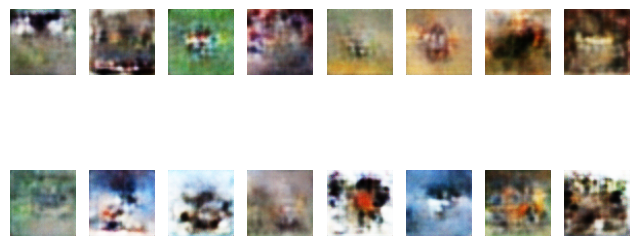

Epoch [31/91], Discriminator Loss: 0.3141, Generator Loss: 2.8953
Epoch [32/91], Discriminator Loss: 0.5604, Generator Loss: 3.0247


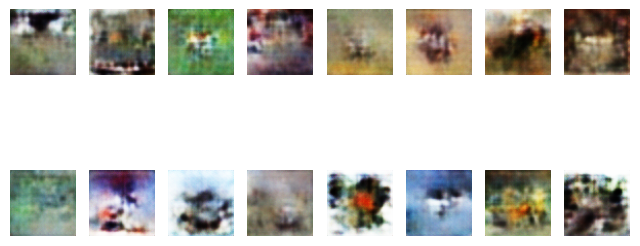

Epoch [33/91], Discriminator Loss: 0.3198, Generator Loss: 2.8454
Epoch [34/91], Discriminator Loss: 0.3612, Generator Loss: 2.8202


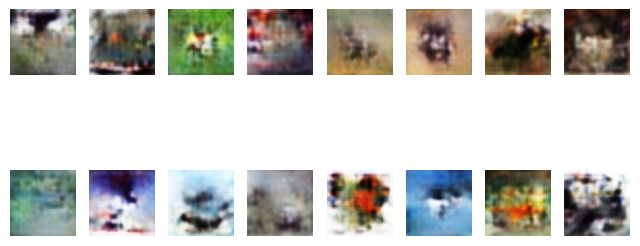

Epoch [35/91], Discriminator Loss: 0.4316, Generator Loss: 2.7912
Epoch [36/91], Discriminator Loss: 0.3902, Generator Loss: 2.7686


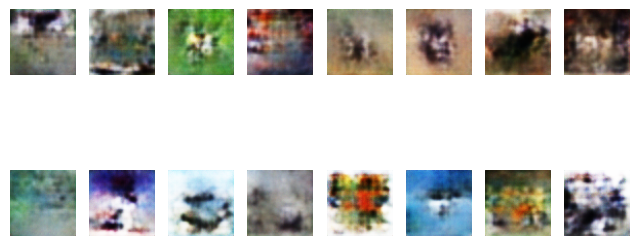

In [ ]:
generator.apply(weights_init)
discriminator.apply(weights_init)

# Loss function
criterion = nn.BCELoss()

# Optimizers
g_optimizer = optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.999))

# Fixed noise for visualization
fixed_noise = torch.randn(num_test_samples, 100, device=device)

# Training loop
discriminator_losses = []
generator_losses = []

for epoch in range(num_epochs):
    # Initialize loss variables for this epoch
    epoch_discriminator_loss = 0
    epoch_generator_loss = 0

    for i, (real_images, _) in enumerate(data_loader):
        real_images = real_images.to(device)

        # Discriminator forward pass with real images
        real_labels = torch.ones(batch_size, 1, device=device)
        real_outputs = discriminator(real_images)
        d_loss_real = criterion(real_outputs, real_labels)

        # Generator forward pass and discriminator backward pass with fake images
        noise = torch.randn(batch_size, 100, device=device)
        fake_images = generator(noise)
        fake_labels = torch.zeros(batch_size, 1, device=device)
        fake_outputs = discriminator(fake_images.detach())
        d_loss_fake = criterion(fake_outputs, fake_labels)

        d_loss = d_loss_real + d_loss_fake

        discriminator.zero_grad()
        d_loss.backward()
        d_optimizer.step()

        # Generator forward pass and discriminator backward pass with fake images
        fake_outputs = discriminator(fake_images)
        g_loss = criterion(fake_outputs, real_labels)

        generator.zero_grad()
        g_loss.backward()
        g_optimizer.step()

        # Accumulate losses for this epoch
        epoch_discriminator_loss += d_loss.item()
        epoch_generator_loss += g_loss.item()

    # Average losses for this epoch
    epoch_discriminator_loss /= len(data_loader)
    epoch_generator_loss /= len(data_loader)

    discriminator_losses.append(epoch_discriminator_loss)
    generator_losses.append(epoch_generator_loss)

    # Print progress
    print(f"Epoch [{epoch+1}/{num_epochs}], Discriminator Loss: {epoch_discriminator_loss:.4f}, Generator Loss: {epoch_generator_loss:.4f}")

    # Generate images
    with torch.no_grad():
        generated_images = generator(fixed_noise).detach().cpu()

    # Display generated images
    if (epoch+1) % 2 == 0 or epoch == 0:
        plt.figure(figsize=(8, 8))
        for j in range(num_test_samples):
            # Denormalize the image
            image = generated_images[j].permute(1, 2, 0)
            image = (image + 1) / 2  # Undo normalization

            plt.subplot(4, 8, j+1)
            plt.imshow(image)
            plt.axis('off')
        plt.show()

# Plotting the loss curve
plt.figure()
plt.plot(range(1, num_epochs+1), discriminator_losses, label="Discriminator Loss")
plt.plot(range(1, num_epochs+1), generator_losses, label="Generator Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.savefig("loss_curve.png")
plt.show()

In [ ]:
# Set random seed for reproducibility
torch.manual_seed(42)

# Hyperparameters
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
batch_size = 100
learning_rate = 0.000075
num_epochs = 200
num_test_samples = 16

In [ ]:
# Data loading and preprocessing
transform = transforms.Compose([
    transforms.Resize(64),
    transforms.ToTensor(),
    transforms.Normalize((.5, .5, .5), (.5, .5, .5))
])

cifar10_dataset = datasets.CIFAR10(root='./data', train=False, transform=transform, download=True)
data_loader = torch.utils.data.DataLoader(cifar10_dataset, batch_size=batch_size, shuffle=True)

Files already downloaded and verified


In [ ]:
# Generator model
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.linear = nn.Linear(100, 1024*4*4)
        self.deconv = nn.Sequential(
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.linear(x)
        x = x.view(x.size(0), 1024, 4, 4)
        x = self.deconv(x)
        return x

In [ ]:
# Discriminator model
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(3, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.output = nn.Sequential(
            nn.Linear(1024*4*4, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.conv(x)
        x = x.view(x.size(0), 1024*4*4)
        x = self.output(x)
        return x


In [ ]:
# Initialize generator and discriminator
generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Weight initialization
def weights_init(module):
    if isinstance(module, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(module.weight.data, 0.0, 0.02)
    elif isinstance(module, nn.BatchNorm2d):
        nn.init.normal_(module.weight.data, 1.0, 0.02)
        nn.init.constant_(module.bias.data, 0)

Epoch [1/200], Discriminator Loss: 0.1665, Generator Loss: 5.5687


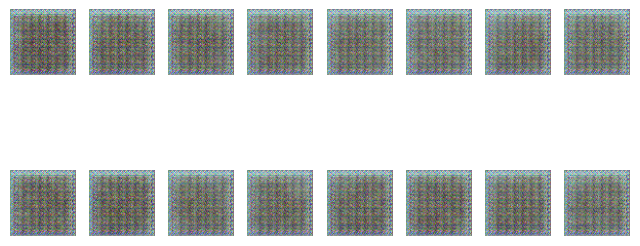

Epoch [2/200], Discriminator Loss: 0.1417, Generator Loss: 7.4618
Epoch [3/200], Discriminator Loss: 0.1615, Generator Loss: 7.8273


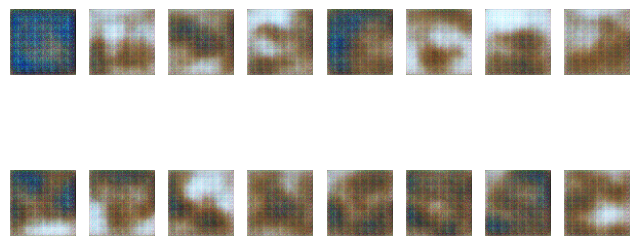

Epoch [4/200], Discriminator Loss: 0.4227, Generator Loss: 5.4092
Epoch [5/200], Discriminator Loss: 0.3941, Generator Loss: 5.1298
Epoch [6/200], Discriminator Loss: 0.2614, Generator Loss: 4.4889


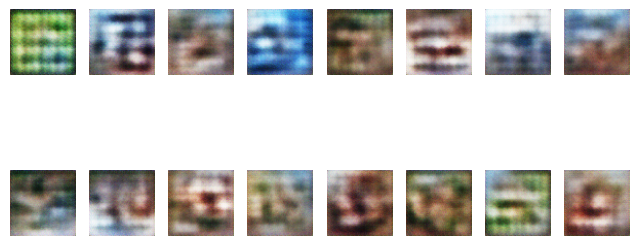

Epoch [7/200], Discriminator Loss: 0.4256, Generator Loss: 4.3993
Epoch [8/200], Discriminator Loss: 0.5419, Generator Loss: 3.8861
Epoch [9/200], Discriminator Loss: 0.4745, Generator Loss: 3.4437


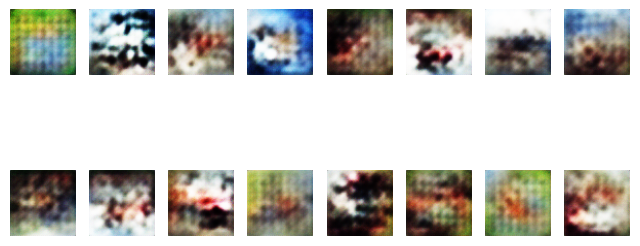

Epoch [10/200], Discriminator Loss: 0.5110, Generator Loss: 3.4349
Epoch [11/200], Discriminator Loss: 0.5033, Generator Loss: 3.3771
Epoch [12/200], Discriminator Loss: 0.5338, Generator Loss: 3.2831


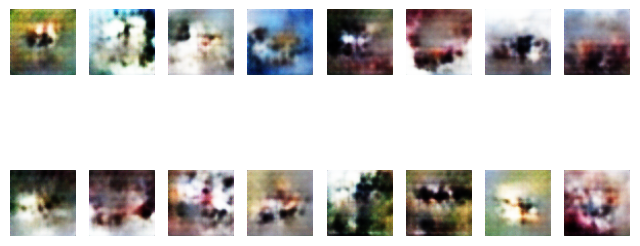

Epoch [13/200], Discriminator Loss: 0.5173, Generator Loss: 3.2014
Epoch [14/200], Discriminator Loss: 0.5479, Generator Loss: 3.1866
Epoch [15/200], Discriminator Loss: 0.5151, Generator Loss: 3.0538


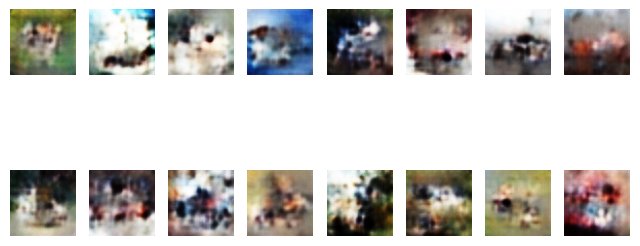

Epoch [16/200], Discriminator Loss: 0.6844, Generator Loss: 2.8730
Epoch [17/200], Discriminator Loss: 0.2817, Generator Loss: 2.9903
Epoch [18/200], Discriminator Loss: 0.5387, Generator Loss: 3.2305


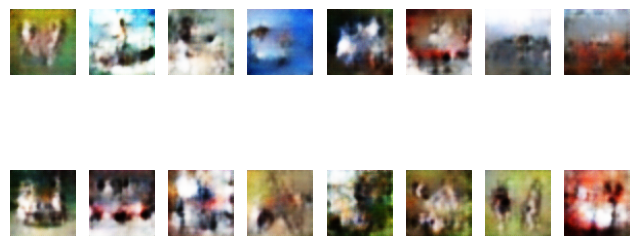

Epoch [19/200], Discriminator Loss: 0.4297, Generator Loss: 3.3959
Epoch [20/200], Discriminator Loss: 0.6030, Generator Loss: 3.4579
Epoch [21/200], Discriminator Loss: 0.2407, Generator Loss: 3.2691


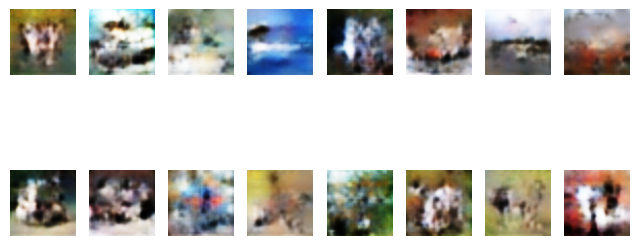

Epoch [22/200], Discriminator Loss: 0.7089, Generator Loss: 3.3286
Epoch [23/200], Discriminator Loss: 0.3183, Generator Loss: 3.3061
Epoch [24/200], Discriminator Loss: 0.5448, Generator Loss: 3.1072


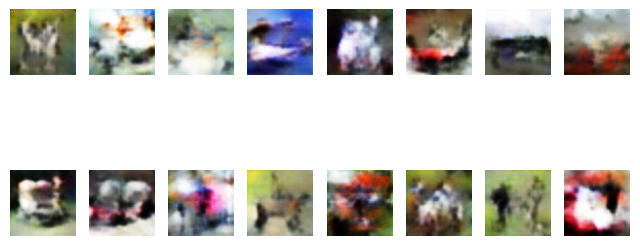

Epoch [25/200], Discriminator Loss: 0.3733, Generator Loss: 3.3511
Epoch [26/200], Discriminator Loss: 0.4744, Generator Loss: 3.3045
Epoch [27/200], Discriminator Loss: 0.5245, Generator Loss: 3.1411


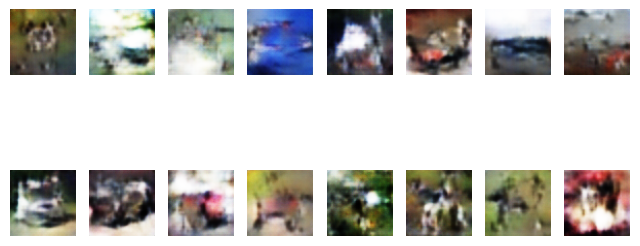

Epoch [28/200], Discriminator Loss: 0.6025, Generator Loss: 2.7500
Epoch [29/200], Discriminator Loss: 0.5523, Generator Loss: 3.1429
Epoch [30/200], Discriminator Loss: 0.4819, Generator Loss: 3.1722


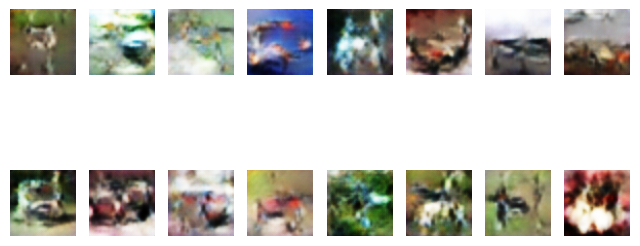

Epoch [31/200], Discriminator Loss: 0.3204, Generator Loss: 3.0776
Epoch [32/200], Discriminator Loss: 0.4941, Generator Loss: 3.1864
Epoch [33/200], Discriminator Loss: 0.1373, Generator Loss: 3.6130


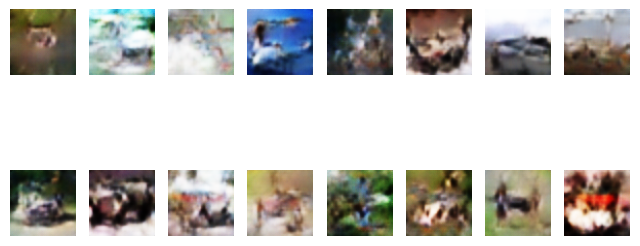

Epoch [34/200], Discriminator Loss: 0.8276, Generator Loss: 3.0541
Epoch [35/200], Discriminator Loss: 0.1637, Generator Loss: 3.5366
Epoch [36/200], Discriminator Loss: 0.7254, Generator Loss: 3.3856


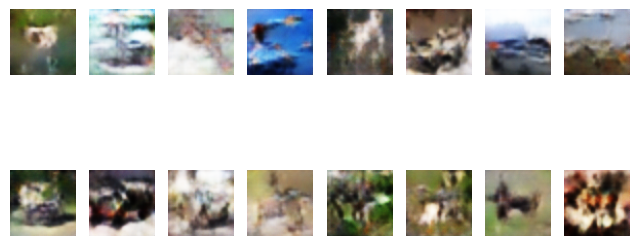

Epoch [37/200], Discriminator Loss: 0.3540, Generator Loss: 3.5466
Epoch [38/200], Discriminator Loss: 0.4915, Generator Loss: 3.4907
Epoch [39/200], Discriminator Loss: 0.3718, Generator Loss: 3.4635


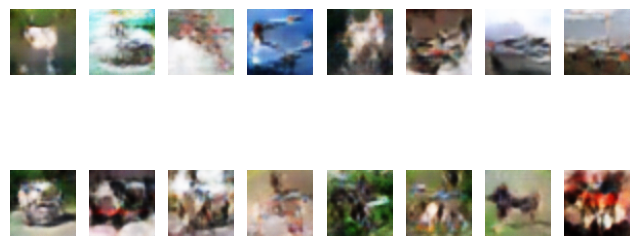

Epoch [40/200], Discriminator Loss: 0.3314, Generator Loss: 3.5921
Epoch [41/200], Discriminator Loss: 0.0800, Generator Loss: 4.0715
Epoch [42/200], Discriminator Loss: 0.0615, Generator Loss: 4.5612


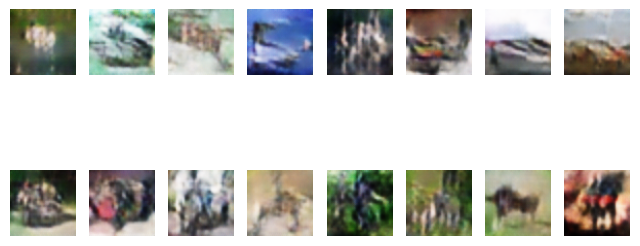

Epoch [43/200], Discriminator Loss: 0.5188, Generator Loss: 4.0817
Epoch [44/200], Discriminator Loss: 0.4956, Generator Loss: 3.6308
Epoch [45/200], Discriminator Loss: 0.5516, Generator Loss: 3.4069


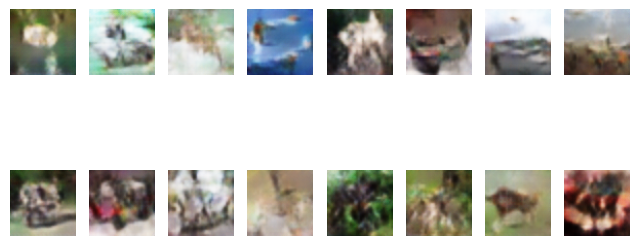

Epoch [46/200], Discriminator Loss: 0.3864, Generator Loss: 3.4893
Epoch [47/200], Discriminator Loss: 0.2178, Generator Loss: 3.9075
Epoch [48/200], Discriminator Loss: 0.3715, Generator Loss: 3.9045


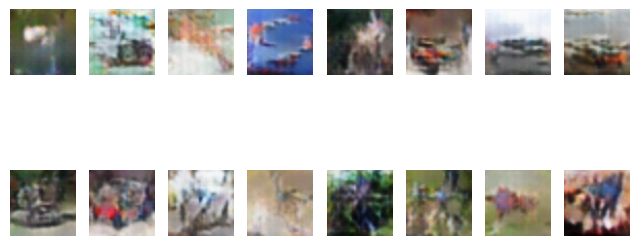

Epoch [49/200], Discriminator Loss: 0.5583, Generator Loss: 3.5142
Epoch [50/200], Discriminator Loss: 0.3563, Generator Loss: 3.5386
Epoch [51/200], Discriminator Loss: 0.3008, Generator Loss: 3.9184


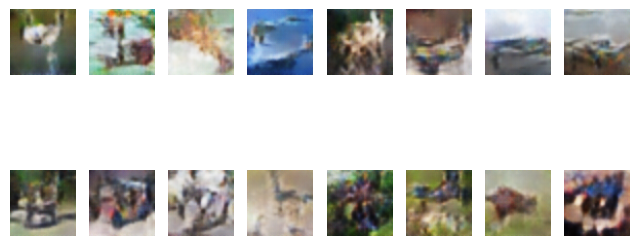

Epoch [52/200], Discriminator Loss: 0.4181, Generator Loss: 4.1572
Epoch [53/200], Discriminator Loss: 0.3418, Generator Loss: 3.3964
Epoch [54/200], Discriminator Loss: 0.5467, Generator Loss: 3.2813


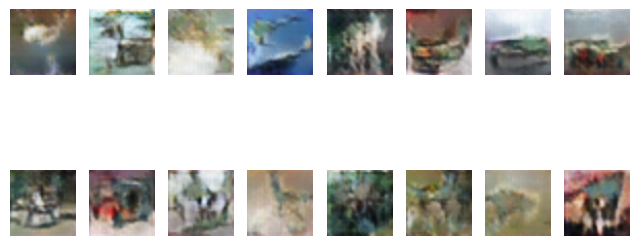

Epoch [55/200], Discriminator Loss: 0.8014, Generator Loss: 3.3237
Epoch [56/200], Discriminator Loss: 0.4025, Generator Loss: 3.7707
Epoch [57/200], Discriminator Loss: 0.0665, Generator Loss: 4.5748


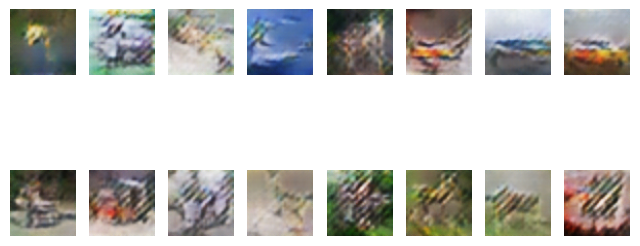

Epoch [58/200], Discriminator Loss: 0.0418, Generator Loss: 5.3860
Epoch [59/200], Discriminator Loss: 0.0281, Generator Loss: 5.6576
Epoch [60/200], Discriminator Loss: 0.0292, Generator Loss: 5.6920


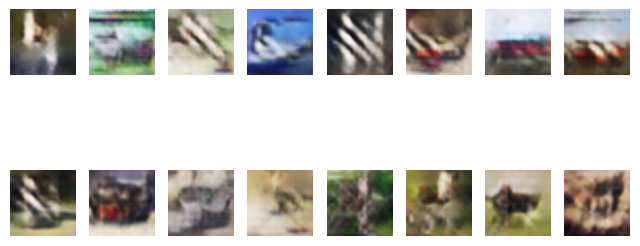

Epoch [61/200], Discriminator Loss: 0.0198, Generator Loss: 5.9031
Epoch [62/200], Discriminator Loss: 0.0181, Generator Loss: 6.3723
Epoch [63/200], Discriminator Loss: 0.2369, Generator Loss: 5.8420


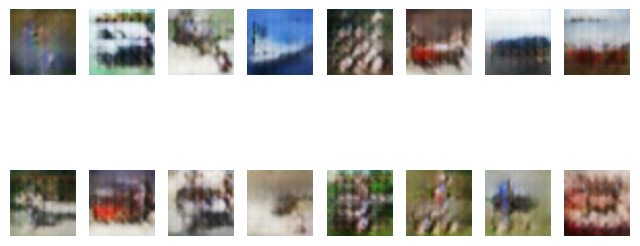

Epoch [64/200], Discriminator Loss: 0.2237, Generator Loss: 4.7667
Epoch [65/200], Discriminator Loss: 0.2108, Generator Loss: 5.1727
Epoch [66/200], Discriminator Loss: 0.5710, Generator Loss: 3.5615


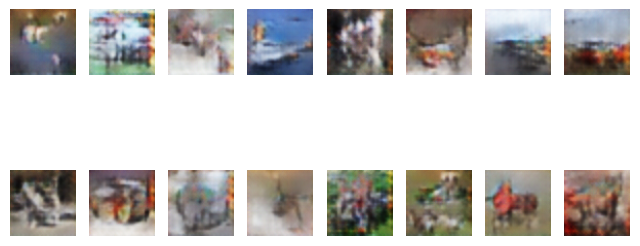

Epoch [67/200], Discriminator Loss: 0.4414, Generator Loss: 4.1955
Epoch [68/200], Discriminator Loss: 0.3886, Generator Loss: 3.9431
Epoch [69/200], Discriminator Loss: 0.5840, Generator Loss: 3.3793


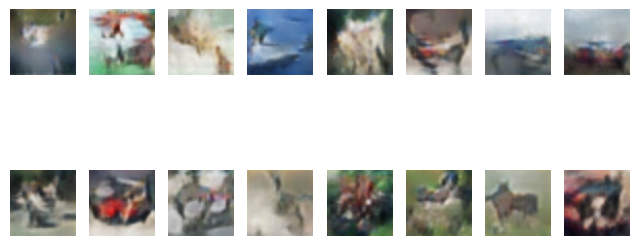

In [ ]:
generator.apply(weights_init)
discriminator.apply(weights_init)

# Loss function
criterion = nn.BCELoss()

# Optimizers
g_optimizer = optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.999))

# Fixed noise for visualization
fixed_noise = torch.randn(num_test_samples, 100, device=device)

# Training loop
discriminator_losses = []
generator_losses = []

for epoch in range(num_epochs):
    # Initialize loss variables for this epoch
    epoch_discriminator_loss = 0
    epoch_generator_loss = 0

    for i, (real_images, _) in enumerate(data_loader):
        real_images = real_images.to(device)

        # Discriminator forward pass with real images
        real_labels = torch.ones(batch_size, 1, device=device)
        real_outputs = discriminator(real_images)
        d_loss_real = criterion(real_outputs, real_labels)

        # Generator forward pass and discriminator backward pass with fake images
        noise = torch.randn(batch_size, 100, device=device)
        fake_images = generator(noise)
        fake_labels = torch.zeros(batch_size, 1, device=device)
        fake_outputs = discriminator(fake_images.detach())
        d_loss_fake = criterion(fake_outputs, fake_labels)

        d_loss = d_loss_real + d_loss_fake

        discriminator.zero_grad()
        d_loss.backward()
        d_optimizer.step()

        # Generator forward pass and discriminator backward pass with fake images
        fake_outputs = discriminator(fake_images)
        g_loss = criterion(fake_outputs, real_labels)

        generator.zero_grad()
        g_loss.backward()
        g_optimizer.step()

        # Accumulate losses for this epoch
        epoch_discriminator_loss += d_loss.item()
        epoch_generator_loss += g_loss.item()

    # Average losses for this epoch
    epoch_discriminator_loss /= len(data_loader)
    epoch_generator_loss /= len(data_loader)

    discriminator_losses.append(epoch_discriminator_loss)
    generator_losses.append(epoch_generator_loss)

    # Print progress
    print(f"Epoch [{epoch+1}/{num_epochs}], Discriminator Loss: {epoch_discriminator_loss:.4f}, Generator Loss: {epoch_generator_loss:.4f}")

    # Generate images
    with torch.no_grad():
        generated_images = generator(fixed_noise).detach().cpu()

    # Display generated images
    if (epoch+1) % 3 == 0 or epoch == 0:
        plt.figure(figsize=(8, 8))
        for j in range(num_test_samples):
            # Denormalize the image
            image = generated_images[j].permute(1, 2, 0)
            image = (image + 1) / 2  # Undo normalization

            plt.subplot(4, 8, j+1)
            plt.imshow(image)
            plt.axis('off')
        plt.show()

# Plotting the loss curve
plt.figure()
plt.plot(range(1, num_epochs+1), discriminator_losses, label="Discriminator Loss")
plt.plot(range(1, num_epochs+1), generator_losses, label="Generator Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.savefig("loss_curve.png")
plt.show()